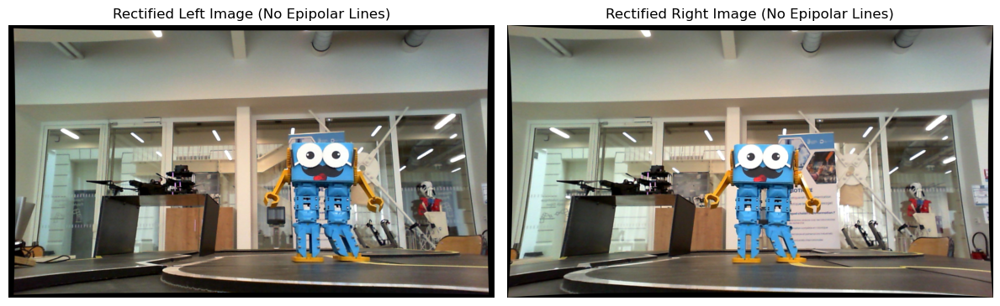

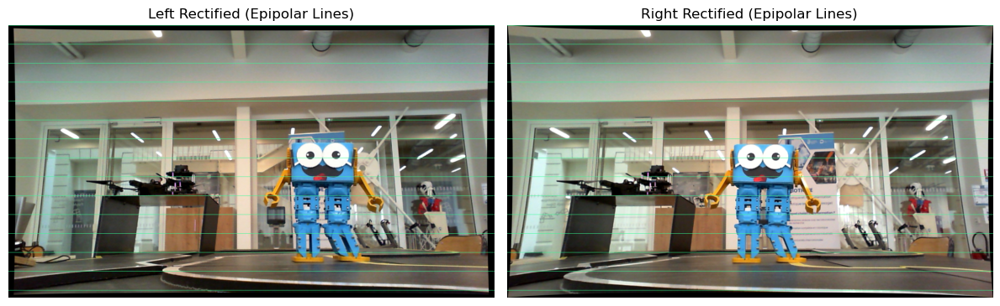

True

In [4]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import json  # Import json instead of yaml

# Load calibration data from JSON file
with open(r'stereo_calibration.json', 'r') as f:  # Change file extension to .json
    calibration_data = json.load(f)  # Use json.load() instead of yaml.load()

# Camera matrix and distortion coefficients
K_left = np.array(calibration_data['K_left'])
D_left = np.array(calibration_data['D_left'])
K_right = np.array(calibration_data['K_right'])
D_right = np.array(calibration_data['D_right'])
image_size = tuple(calibration_data['image_size'])  # (width, height)

# Extract the stereo calibration data
R = np.eye(3)
T = np.array([[-0.1], [0.0], [0.0]])
R1 = np.array(calibration_data['R1'])
R2 = np.array(calibration_data['R2'])
P1 = np.array(calibration_data['P1'])
P2 = np.array(calibration_data['P2'])
Q = np.array(calibration_data['Q'])

# Load left and right images for rectification
LEFT_IMAGE_PATH = r"dataset_2/stereo/left.png"   # Use raw string
RIGHT_IMAGE_PATH = r"dataset_2/stereo/right.png"  # Use raw string

# Read images
img_left = cv2.imread(LEFT_IMAGE_PATH)
img_right = cv2.imread(RIGHT_IMAGE_PATH)

# Convert images to grayscale (optional, useful for rectification)
gray_left = cv2.cvtColor(img_left, cv2.COLOR_BGR2GRAY)
gray_right = cv2.cvtColor(img_right, cv2.COLOR_BGR2GRAY)

# Undistort images using camera calibration data
img_left_undistorted = cv2.undistort(img_left, K_left, D_left)
img_right_undistorted = cv2.undistort(img_right, K_right, D_right)

# Stereo rectification (compute the rectification transforms)
rectify_scale = 1.0  # Full image area
# After loading calibration data


# In stereoRectify:

(R1, R2, P1, P2, Q, roi1, roi2) = cv2.stereoRectify(
    cameraMatrix1=K_left, distCoeffs1=D_left,
    cameraMatrix2=K_right, distCoeffs2=D_right,
    imageSize=image_size, R=R, T=T,
    flags=cv2.CALIB_ZERO_DISPARITY, alpha=rectify_scale
)

# In initUndistortRectifyMap:
map_left_x, map_left_y = cv2.initUndistortRectifyMap(
    K_left, D_left, R1, P1, image_size, cv2.CV_32FC1)
map_right_x, map_right_y = cv2.initUndistortRectifyMap(
    K_right, D_right, R2, P2, image_size, cv2.CV_32FC1)


# Remap the images using the rectification maps
img_left_rectified = cv2.remap(img_left_undistorted, map_left_x, map_left_y, cv2.INTER_LINEAR)
img_right_rectified = cv2.remap(img_right_undistorted, map_right_x, map_right_y, cv2.INTER_LINEAR)

# --- Display rectified images WITHOUT epipolar lines ---
plt.figure(figsize=(12, 6))
plt.subplot(121), plt.imshow(cv2.cvtColor(img_left_rectified, cv2.COLOR_BGR2RGB))
plt.title("Rectified Left Image (No Epipolar Lines)"), plt.axis('off')
plt.subplot(122), plt.imshow(cv2.cvtColor(img_right_rectified, cv2.COLOR_BGR2RGB))
plt.title("Rectified Right Image (No Epipolar Lines)"), plt.axis('off')
plt.tight_layout()
plt.show()

# Parameters for epipolar lines
LINE_COLOR = (150, 255, 50)  # BGR format (teal color)
LINE_THICKNESS = 1
LINE_INTERVAL = 50

# Create copies for drawing lines
img_left_with_lines = img_left_rectified.copy()
img_right_with_lines = img_right_rectified.copy()

# Draw horizontal epipolar lines
for y in range(0, img_left_with_lines.shape[0], LINE_INTERVAL):
    cv2.line(img_left_with_lines, (0, y), (img_left_with_lines.shape[1], y), LINE_COLOR, LINE_THICKNESS)
    cv2.line(img_right_with_lines, (0, y), (img_right_with_lines.shape[1], y), LINE_COLOR, LINE_THICKNESS)

# --- Display rectified images WITH epipolar lines ---
plt.figure(figsize=(12, 6))
plt.subplot(121), plt.imshow(cv2.cvtColor(img_left_with_lines, cv2.COLOR_BGR2RGB))
plt.title(f"Left Rectified (Epipolar Lines)"), plt.axis('off')
plt.subplot(122), plt.imshow(cv2.cvtColor(img_right_with_lines, cv2.COLOR_BGR2RGB))
plt.title(f"Right Rectified (Epipolar Lines)"), plt.axis('off')
plt.tight_layout()
plt.show()

# Save all versions.
cv2.imwrite(r"rectified_images/left_rectified.png", img_left_rectified)  # Use raw string
cv2.imwrite(r"rectified_images/right_rectified.png", img_right_rectified)  # Use raw string
cv2.imwrite(r"rectified_images/left_rectified_with_lines.png", img_left_with_lines)  # Use raw string
cv2.imwrite(r"rectified_images/right_rectified_with_lines.png", img_right_with_lines)  # Use raw string

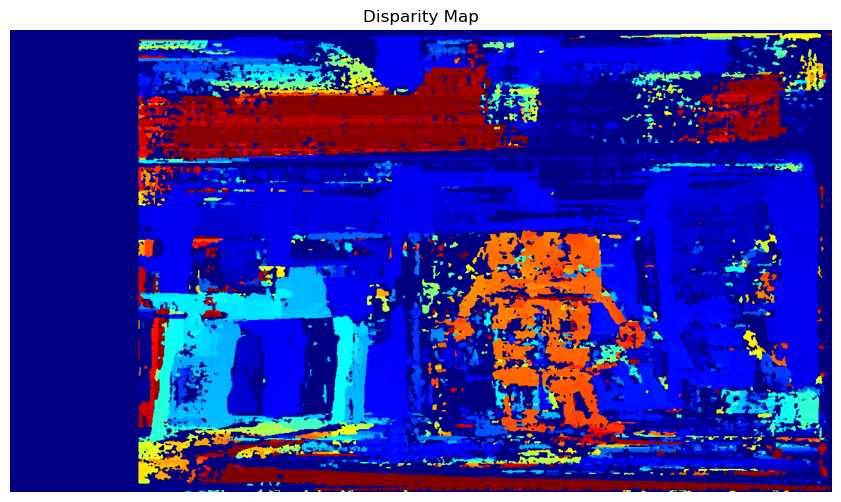

In [5]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import yaml

# Load calibration data from JSON file
with open(r'stereo_calibration.json', 'r') as f:  # Change file extension to .json
    calibration_data = json.load(f)  # Use json.load() instead of yaml.load()

image_size = tuple(calibration_data['image_size'])  # (width, height)

def compute_disparity(rectified_left, rectified_right):
    """
    Compute the disparity map using a single stage of StereoSGBM.
    """

    # Ensure images match calibration size
    if rectified_left.shape[1::-1] != image_size:
        raise ValueError(f"Left image size {rectified_left.shape[1::-1]} doesn't match calibration size {image_size}")
    if rectified_right.shape[1::-1] != image_size:
        raise ValueError(f"Right image size {rectified_right.shape[1::-1]} doesn't match calibration size {image_size}")

    # Convert images to grayscale if they are in color
    if len(rectified_left.shape) == 3:
        rectified_left = cv2.cvtColor(rectified_left, cv2.COLOR_BGR2GRAY)
        rectified_right = cv2.cvtColor(rectified_right, cv2.COLOR_BGR2GRAY)

    # StereoSGBM parameters (adjusted for smoother results)
    stereo = cv2.StereoSGBM_create(
        minDisparity=0,
        numDisparities=200,  # Adjust based on your scene
        blockSize=7,         # Increased block size for better matching
        P1=8 * 3 * 5**2,
        P2=32 * 3 * 5**2,
        disp12MaxDiff=1,
        uniquenessRatio=2,
        speckleWindowSize=10,
        speckleRange=7,
        preFilterCap=2,
        mode=cv2.STEREO_SGBM_MODE_SGBM_3WAY
    )

    # Compute disparity map
    disparity = stereo.compute(rectified_left, rectified_right).astype(np.float32) / 16.0

    # Post-processing and clipping
    disparity = np.clip(disparity, 0, 255)

    # Normalize disparity to 0-255 for proper heatmap visualization
    disparity_normalized = cv2.normalize(disparity, None, 0, 255, cv2.NORM_MINMAX)

    # Apply heatmap color map
    disparity_colored = cv2.applyColorMap(disparity_normalized.astype(np.uint8), cv2.COLORMAP_JET)

    plt.figure(figsize=(12, 6))
    plt.imshow(cv2.cvtColor(disparity_colored, cv2.COLOR_BGR2RGB))
    plt.title('Disparity Map'), plt.axis('off')
    plt.show()

    return disparity

# Call the function (assuming rectified images already exist)
disparity_map = compute_disparity(img_left_rectified, img_right_rectified)

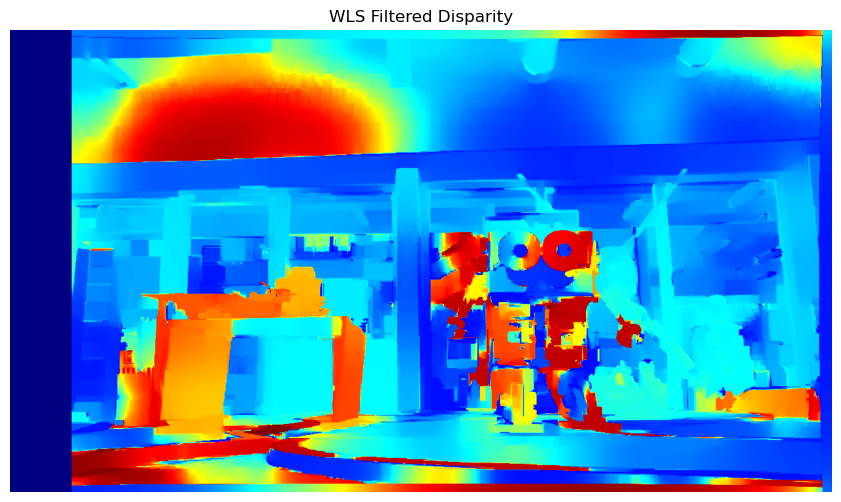

In [6]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# 1) Load & resize your rectified images
TARGET_WIDTH  = 1280
TARGET_HEIGHT = 720
img_left_rectified  = cv2.imread(r"rectified_images/left_rectified.png")
img_right_rectified = cv2.imread(r"rectified_images/right_rectified.png")

def resize_images(l, r, w=TARGET_WIDTH, h=TARGET_HEIGHT):
    return (cv2.resize(l, (w, h), interpolation=cv2.INTER_AREA),
            cv2.resize(r, (w, h), interpolation=cv2.INTER_AREA))

# 2) Compute WLS‐filtered disparity
def compute_wls_filtered_disparity(L, R):
    L, R = resize_images(L, R)

    left_matcher = cv2.StereoSGBM_create(
        minDisparity=0,
        numDisparities=16*6,
        blockSize=11,
        P1=8*3*11**2,
        P2=32*3*11**2,
        disp12MaxDiff=1,
        uniquenessRatio=10,
        speckleWindowSize=100,
        speckleRange=32,
        mode=cv2.STEREO_SGBM_MODE_SGBM_3WAY
    )
    right_matcher = cv2.ximgproc.createRightMatcher(left_matcher)

    left_disp  = left_matcher.compute(L, R).astype(np.float32)/16.0
    right_disp = right_matcher.compute(R, L).astype(np.float32)/16.0

    wls = cv2.ximgproc.createDisparityWLSFilter(left_matcher)
    wls.setLambda(10000); wls.setSigmaColor(1.2)
    filtered = wls.filter(left_disp, L, None, right_disp)
    filtered = np.nan_to_num(filtered, nan=0.0, posinf=0.0, neginf=0.0)

    # Normalize the disparity for proper visualization
    disp_norm = cv2.normalize(filtered, None, 0, 255,
                              cv2.NORM_MINMAX, cv2.CV_8U)

    # Apply color map (heatmap)
    disp_col = cv2.applyColorMap(disp_norm, cv2.COLORMAP_JET)

    # Plot the disparity map
    plt.figure(figsize=(12, 6))
    plt.imshow(cv2.cvtColor(disp_col, cv2.COLOR_BGR2RGB))
    plt.title('WLS Filtered Disparity')
    plt.axis('off')
    plt.show()

    # Save the filtered disparity map
    cv2.imwrite(r"disparity_map/disparity_filtered_wls.png", disp_col)

    return filtered

# Run it
wls_disparity = compute_wls_filtered_disparity(
    img_left_rectified, img_right_rectified
)

In [7]:
import cv2
import numpy as np
import json
import open3d as o3d

# 1) Basic disparity stats
disp = wls_disparity.astype(np.float32)
print(f"Disparity: min={disp.min():.3f}, max={disp.max():.3f}, mean={np.nanmean(disp):.3f}")
print(f"Pixels with disp>0: {np.count_nonzero(disp>0)} / {disp.size}")

# 2) Load Q from your JSON
with open(r'stereo_calibration.json','r') as f:
    calib = json.load(f)

Q = np.array(calib['Q'], dtype=np.float32)
# print("Using Q matrix:\n", Q)

# 3) Reproject to 3D
points3d = cv2.reprojectImageTo3D(disp, Q)

# 4) Mask: keep disp > 5th percentile of positive values
pos = disp[disp>0]
thr = np.percentile(pos, 5) if pos.size else 0
mask = disp > thr
# print(f"Mask threshold={thr:.3f}, points kept: {np.count_nonzero(mask)}")

# 5) Extract & color
img_color = cv2.resize(img_left_rectified,
                       (TARGET_WIDTH, TARGET_HEIGHT),
                       interpolation=cv2.INTER_AREA)
pts  = points3d[mask]
cols = cv2.cvtColor(img_color, cv2.COLOR_BGR2RGB)[mask]

# 6) Downsample ~100k pts for speed
step = max(1, len(pts)//100000)
pts_ds  = pts[::step]
cols_ds = cols[::step]
# print(f"Displaying {len(pts_ds)} points (every {step}th)")

# 7) Open3D visualize
# 7) Open3D visualize (but first flip so “up” in image → up in 3D, and front faces you)
pcd = o3d.geometry.PointCloud()
pcd.points = o3d.utility.Vector3dVector(pts_ds)
pcd.colors = o3d.utility.Vector3dVector(cols_ds.astype(np.float64)/255.0)

# Flip 180° about X axis:
import numpy as np
R = np.array([[1,  0,   0],
              [0, -1,   0],
              [0,  0,  -1]], dtype=np.float64)
pcd.rotate(R, center=(0,0,0))

o3d.visualization.draw_geometries([pcd])

Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.
Disparity: min=-16.000, max=95.000, mean=25.788
Pixels with disp>0: 835709 / 921600


In [8]:
import cv2
import numpy as np
import json
import open3d as o3d
from PIL import Image

# 1) Basic disparity stats
disp = wls_disparity.astype(np.float32)
print(f"Disparity: min={disp.min():.3f}, max={disp.max():.3f}, mean={np.nanmean(disp):.3f}")
print(f"Pixels with disp>0: {np.count_nonzero(disp>0)} / {disp.size}")

# 2) Load Q from your JSON
with open(r'stereo_calibration.json','r') as f:
    calib = json.load(f)

Q = np.array(calib['Q'], dtype=np.float32)

# 3) Reproject to 3D
points3d = cv2.reprojectImageTo3D(disp, Q)

# 4) Mask: keep disp > 5th percentile of positive values
pos = disp[disp>0]
thr = np.percentile(pos, 5) if pos.size else 0
mask = disp > thr

# 5) Extract & color
img_color = cv2.resize(img_left_rectified,
                       (TARGET_WIDTH, TARGET_HEIGHT),
                       interpolation=cv2.INTER_AREA)
pts  = points3d[mask]
cols = cv2.cvtColor(img_color, cv2.COLOR_BGR2RGB)[mask]

# 6) Downsample ~100k pts for speed
step = max(1, len(pts)//100000)
pts_ds  = pts[::step]
cols_ds = cols[::step]

# 7) Open3D visualize (but first flip so “up” in image → up in 3D, and front faces you)
pcd = o3d.geometry.PointCloud()
pcd.points = o3d.utility.Vector3dVector(pts_ds)
pcd.colors = o3d.utility.Vector3dVector(cols_ds.astype(np.float64)/255.0)

# Flip 180° about X axis:
R = np.array([[1,  0,   0],
              [0, -1,   0],
              [0,  0,  -1]], dtype=np.float64)
pcd.rotate(R, center=(0,0,0))

# 8) Create GIF frames by rotating the point cloud
frames = []
for i in range(0, 360, 5):  # Rotate 360 degrees, with a step of 5 degrees
    # Rotate the point cloud
    R_rotate = pcd.get_rotation_matrix_from_axis_angle(np.array([0, 1, 0]) * np.radians(i))
    pcd.rotate(R_rotate, center=(0, 0, 0))
    
    # Visualize and capture the current frame as an image
    vis = o3d.visualization.Visualizer()
    vis.create_window(visible=False)  # Hide the window
    vis.add_geometry(pcd)
    vis.poll_events()
    vis.update_renderer()
    
    # Capture the current frame
    image = vis.capture_screen_float_buffer(False)
    image = np.asarray(image)
    img_pil = Image.fromarray((image * 255).astype(np.uint8))  # Convert to uint8
    frames.append(img_pil)
    
    # Clear geometry for next iteration
    vis.clear_geometries()

# 9) Save as GIF
frames[0].save('point_cloud_rotation.gif', save_all=True, append_images=frames[1:], duration=100, loop=0)

print("GIF saved as 'point_cloud_rotation.gif'.")

Disparity: min=-16.000, max=95.000, mean=25.788
Pixels with disp>0: 835709 / 921600
GIF saved as 'point_cloud_rotation.gif'.


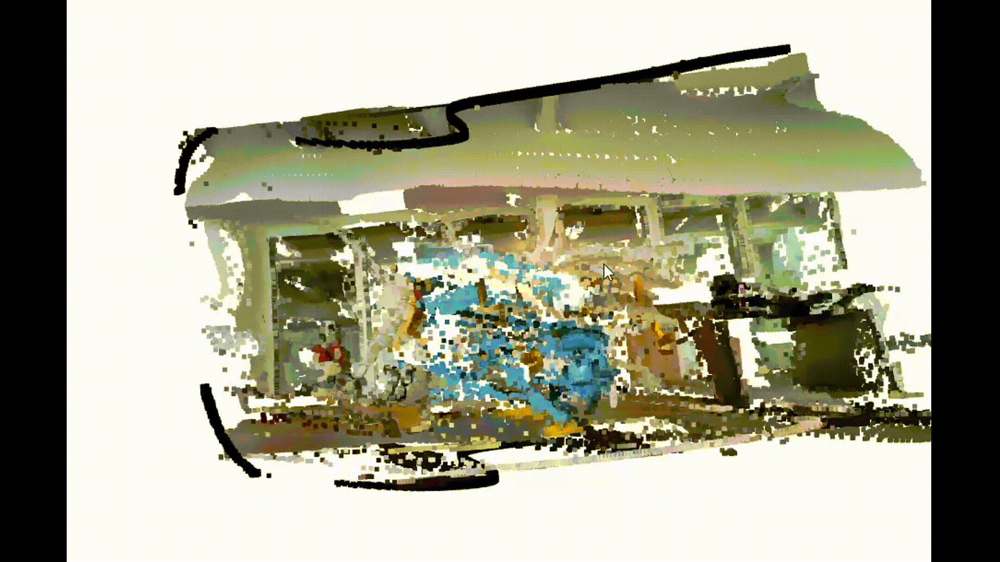

In [9]:
from IPython.display import Image, display

def display_gif(gif_path):
    display(Image(filename=gif_path))

# Use the function with your GIF path
display_gif(r'3dpc.gif')

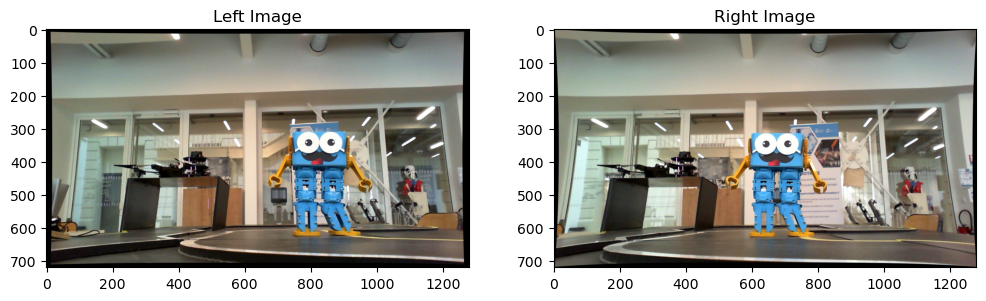

In [10]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import yaml

# Load stereo images
img_left = cv2.imread(r'rectified_images/left_rectified.png')  # Update path
img_right = cv2.imread(r'rectified_images/right_rectified.png')  # Update path

# Load calibration data
with open(r'stereo_calibration.json','r') as f:
    calib = json.load(f)

# Convert lists to numpy arrays
for key in ['K_left', 'K_right', 'P1', 'P2', 'R', 'T']:
    calib[key] = np.array(calib[key])

# Display sample images
plt.figure(figsize=(12, 6))
plt.subplot(121), plt.imshow(cv2.cvtColor(img_left, cv2.COLOR_BGR2RGB)), plt.title('Left Image')
plt.subplot(122), plt.imshow(cv2.cvtColor(img_right, cv2.COLOR_BGR2RGB)), plt.title('Right Image')
plt.show()

Keypoints detected - Left: 5000, Right: 5000


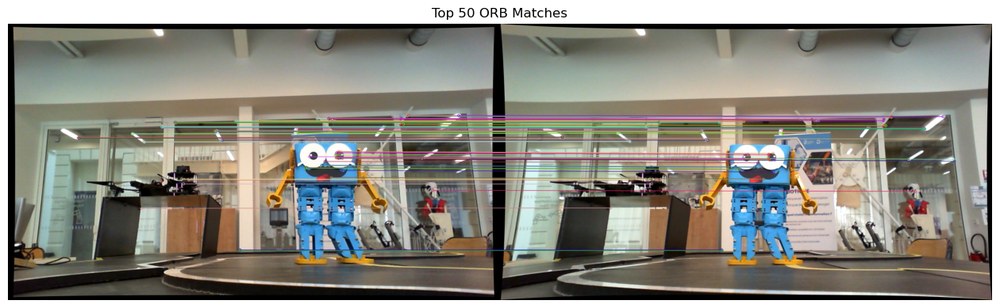

In [11]:
# # 2. Feature Matching with ORB + BFMatcher

# %%
# Initialize ORB detector
orb = cv2.ORB_create(5000)

# Detect keypoints and compute descriptors
kp1, des1 = orb.detectAndCompute(img_left, None)
kp2, des2 = orb.detectAndCompute(img_right, None)

print(f"Keypoints detected - Left: {len(kp1)}, Right: {len(kp2)}")

# Match descriptors using Brute-Force Matcher
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
matches = bf.match(des1, des2)
matches = sorted(matches, key=lambda x: x.distance)

# Visualize top 50 matches
img_matches = cv2.drawMatches(img_left, kp1, img_right, kp2, matches[:100], None, flags=2)

plt.figure(figsize=(16, 8))
plt.imshow(cv2.cvtColor(img_matches, cv2.COLOR_BGR2RGB))
plt.title('Top 50 ORB Matches'), plt.axis('off')
plt.show()

# Prepare matched points
pts1 = np.float32([kp1[m.queryIdx].pt for m in matches]).reshape(-1, 2)
pts2 = np.float32([kp2[m.trainIdx].pt for m in matches]).reshape(-1, 2)

In [12]:
# # 3. Fundamental Matrix and Inlier Filtering
F, inliers = cv2.findFundamentalMat(pts1, pts2, 
                                  method=cv2.FM_RANSAC,
                                  ransacReprojThreshold=3.0,  # Increased from 1.0
                                  confidence=0.999)           # Higher confidence

pts1 = pts1[inliers.ravel() == 1]
pts2 = pts2[inliers.ravel() == 1]

print(f"Initial matches: {len(matches)}")
print(f"Inlier matches after RANSAC: {len(pts1)}")
print(f"Fundamental matrix:\n{F.round(3)}")

Initial matches: 1724
Inlier matches after RANSAC: 938
Fundamental matrix:
[[ 0.     0.    -0.005]
 [-0.     0.     0.062]
 [ 0.004 -0.066  1.   ]]
